# Introduction and theorical context

Variational Autoencoders (VAEs) and Generative Adversarial Networks (GANs) are two generative models with novel capabilities in generating realistic data. Over this assignment, various architectures of each type of model were built in order to scrabble a little about their core concepts to understand it better. The CelebA dataset was used, consisting on 200k images of faces. For the GAN architecture, the Fréchet Inception Distance was computed for the generated samples at various momments during the trainning process to measure the dissimilarity between generated images and reference ones. Also, for this kind of models, other experiments were performed like playing with interpolation of points in the latent space of generate random images from initial noise. At last, some conclussions about each architecture were exposed. In this section, we begin reviewing some key concepts of Autoencoders and Generative Adversarial Networks.

Autoencoders are neural networks that aim to learn a latent representation of some data by encoding it into a lower dimensional space. It consists on a encoder and a decoder. The encoder maps the input data into a latent space representation, and the decoder tries to reconstruct the original input data from the latent representation. However, on Variational Autoencoders (VAEs), the encoder doesn´t output a latent vector but rather the parameters of a probability distribution in the latent space (typically, assumed to be Gaussian). The stochastic nature of this process enables the VAE to generate more diverse samples during the decoding process.

Generative Adversarial Networks (GANs) is a nother approach to generative modeling, formulating it as a game between a generator and a discriminator. The generator tries to produce better (realistic) images, while the discriminator aims to distinguish between real and generated images. There is some well known problems on the training of GANs, like the difference on how faster the discriminator and the generator learn. This problems usually entail to vanishing gradient problems and mode collapsing problems that provoke for example the generator to not improve or the discriminator to give worse and less meaningful feedback over time. Wessertein loss is measure of the distance between two probability distributions, and is used in so called WGANs as a way to treat with this difficulties. In this type of models, the discriminator outputs a number instead of a classification. WGAN-GP (Wessertein GANs with gradient penality) adds regularization in the form of gradient penality in order to ensure Lipschitz continuity property and avoid the discriminator to overfit. At last, other type of GANs, Deep Convolutional GANs (DCGANs) have the particularity of use CNNs on the discriminator and generator to capture spatial relationships in the input data. 

# Data Preprocessing

Importing the used libraries. Here *disable_eager_execution()* is called in order to avoid errors with sampling function when running the VAE. Eager execution enables the execution of tensorflow operations inmediatly, what can be conflictive with the way the Encoder and the sampling function is designed. Once deactivated, it relies on a graph to compute them in a certain order.

In [2]:
%load_ext autoreload
%autoreload 2

import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import tensorflow as tf
from tensorflow.keras.layers import Input, Dense, Flatten, Reshape, Conv2D, Conv2DTranspose, Lambda, MaxPooling2D, GlobalAvgPool2D
from tensorflow.keras.models import Model
from tensorflow.keras import backend as K
from tensorflow.keras.optimizers import Adam
from tensorflow.keras import layers, models, callbacks, utils, metrics, optimizers

from tensorflow.python.framework.ops import disable_eager_execution, enable_eager_execution
disable_eager_execution()

import numpy as np
import matplotlib.pyplot as plt

global K
K.clear_session()

from utils import display, sample_batch


Checking device to run on:

In [2]:
devices = tf.config.list_physical_devices('GPU')
if len(devices) > 0:
    print('GPU is available.')
    for device in devices:
        print('Device name:', device.name)
else:
    print('GPU is not available. Running on CPU.')

GPU is available.
Device name: /physical_device:GPU:0


2023-05-21 23:18:03.486366: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:939] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-05-21 23:18:03.507487: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:939] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-05-21 23:18:03.507666: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:939] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero


Reading the data and defining the data variables

In [36]:
DATASET_PATH = "/home/kirle/Master/2cuatrimestre/Deep Learning/Practice/Lab5 - GANs/Dataset/archive/img_align_celeba"
BATCH_SIZE = 32
IMG_SIZE = 256

data_gen = ImageDataGenerator(rescale=1./255)
data_flow = data_gen.flow_from_directory(DATASET_PATH,
                                          target_size=(256, 256),
                                          batch_size=BATCH_SIZE,
                                          shuffle=True,
                                          class_mode='input',
                                          subset='training',
                                          color_mode='rgb')


Found 202599 images belonging to 1 classes.


Showing a sample of the readed data

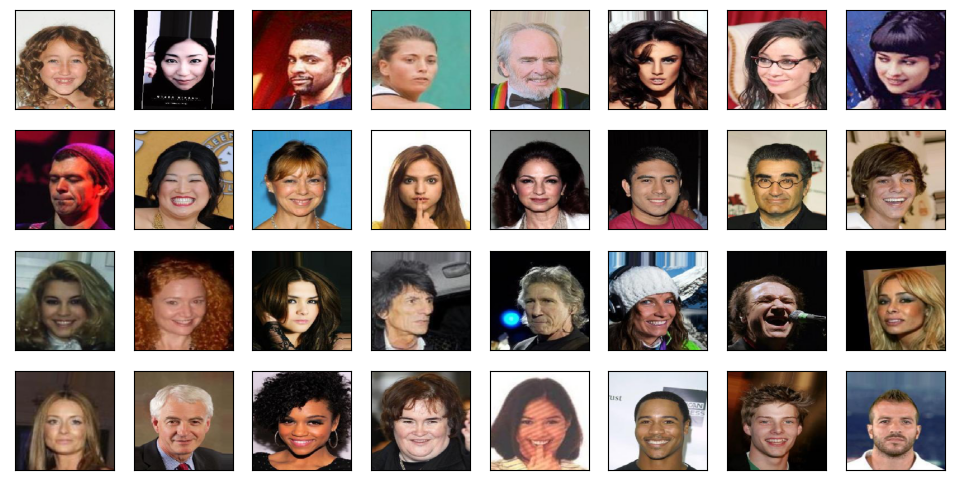

In [37]:
batch = next(data_flow)
images = batch[0]
fig, axes = plt.subplots(4, 8, figsize=(12, 6),
                         subplot_kw={'xticks': [], 'yticks': []})

for i, ax in enumerate(axes.flat):
    ax.imshow(images[i])
    
plt.show()

# Training Comparisons and Evaluations 

## VAEs training

Defyning loss functions and another one to plot a comparision between images. *r_loss()* calculates the reconstruction loss between ground truth input and predicted output. *kl_loss* computes the Kullback-Leibler divergence loss, and *total_loss()* computes the total loss combination the two previous ones and a scaling factor.

In [38]:
def r_loss(y_true, y_pred):
    return K.mean(K.square(y_true - y_pred), axis = [1,2,3])

def kl_loss(y_true, y_pred):
    kl_loss =  -0.5 * K.sum(1 + log_var - K.square(mean_mu) - K.exp(log_var), axis = 1)
    return kl_loss

def total_loss(y_true, y_pred):
    return LOSS_FACTOR*r_loss(y_true, y_pred) + kl_loss(y_true, y_pred)


def plot_compare_VAE(images, add_noise=False):
    
    n_to_show = images.shape[0]

    if add_noise:
        encodings = VAE_encoder.predict(images)
        encodings += np.random.normal(0.0, 1.0, size = (n_to_show,200))
        reconst_images = VAE_decoder.predict(encodings)

    else:
        reconst_images = vae.predict(images)


    fig = plt.figure(figsize=(12, 3))
    fig.subplots_adjust(left=0.05, bottom=0.05, right=0.95, top=0.95, hspace=0.1, wspace=0.1)

    for i in range(n_to_show):
        #img = images[i].squeeze()
        img = images[i]
        sub = fig.add_subplot(2, n_to_show, i+1)
        sub.axis('off')        
        sub.imshow(img,cmap='gray')

    for i in range(n_to_show):
        img = reconst_images[i].squeeze()
        sub = fig.add_subplot(2, n_to_show, i+n_to_show+1)
        sub.axis('off')
        sub.imshow(img,cmap='gray')
    plt.show()
            
    

The encoder was build a set of Conv2D layers with increasing number of filters, a 3x3 kernel and strides=2. Each layer reduces the size of the input image (at the beginning of 256x256) while increasing the number of channels. last Conv2D layer outputs a (16, 16, 512) output matrix, which is also the input size for the decoder. After the last Conv2D layer, the results are flattened to create a 1-dimensional vector. This vector is then passed through two dense layers: 'mu' and 'log_var'. These layers output the mean and logarithm of the variance of the latent distribution, respectively. These values represent the parameters of the learned distribution in the latent space. The decoder was built as a combination of transpose Conv2D layer that ends returning the image to its original size. Finally, the VAE is built combining this two networks.

In [5]:
LATENT_DIM = 256
# --------------------
# Building the encoder
# --------------------

encoder_input = Input(shape=(IMG_SIZE, IMG_SIZE, 3))
x = Conv2D(64, kernel_size=3, strides=2, padding="same", activation="relu")(encoder_input)
x = Conv2D(128, kernel_size=3, strides=2, padding="same", activation="relu")(x)
x = Conv2D(256, kernel_size=3, strides=2, padding="same", activation="relu")(x)
x = Conv2D(512, kernel_size=3, strides=2, padding="same", activation="relu")(x)
shape_before_flattening = K.int_shape(x)[1:] 

x = Flatten()(x)

# Mean and variance of the latent distribution
mean_mu = Dense(LATENT_DIM,name = 'mu')(x)
log_var = Dense(LATENT_DIM,name = 'log_var')(x)

def sampling(args):
        mean_mu, log_var = args
        epsilon = K.random_normal(shape=K.shape(mean_mu), mean=0., stddev=1.) 
        return mean_mu + K.exp(log_var/2)*epsilon 
    
encoder_output = Lambda(sampling, name='encoder_output')([mean_mu, log_var])

print(f"Shape before flattening: {shape_before_flattening})

# --------------------
# Building the decoder
# --------------------

decoder_input = Input(shape=(LATENT_DIM,))
x = Dense(np.prod(shape_before_flattening), activation="relu")(decoder_input)
x = Reshape(shape_before_flattening)(x) # Conv2DTranspose expects a 3D input tensor
x = Conv2DTranspose(256, kernel_size=3, strides=2, padding="same", activation="relu")(x) #Upsampling feature map 
x = Conv2DTranspose(128, kernel_size=3, strides=2, padding="same", activation="relu")(x)
x = Conv2DTranspose(64, kernel_size=3, strides=2, padding="same", activation="relu")(x)
x = Conv2DTranspose(3, kernel_size=3, strides=2, padding="same", activation="relu")(x)

decoder_output = x
      
# --------------------
# Full autoencoder
# --------------------
      
vae_encoder = Model(encoder_input, encoder_output)
vae_decoder = Model(decoder_input, decoder_output)

vae_input = encoder_input
vae_output = vae_decoder(encoder_output) 

# Input to the combined model will be the input to the encoder.
# Output of the combined model will be the output of the decoder.
vae = Model(vae_input, vae_output)

In [17]:
print("---------------------------")
print(" \n Encoder : \n")
print("---------------------------\n\n\n")
print(vae_encoder.summary())
print("\n\n\n---------------------------")
print("\n Decoder : \n")
print("---------------------------\n\n\n")
print(vae_decoder.summary())
print("\n\n\n---------------------------")
print("\n Variational Autoencoder (Full) : \n")
print("---------------------------\n\n\n")
print(vae.summary())

---------------------------
 
 Encoder : 

---------------------------



Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d (Conv2D)                (None, 128, 128, 64  1792        ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 conv2d_1 (Conv2D)              (None, 64, 64, 128)  73856       ['conv2d[0][0]']                 
                    

On this first try, the training was run during **just one iteration**:

/home/kirle/anaconda3/envs/tf/lib/python3.9/site-packages/keras/engine/training_v1.py:2079: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates=self.state_updates,
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


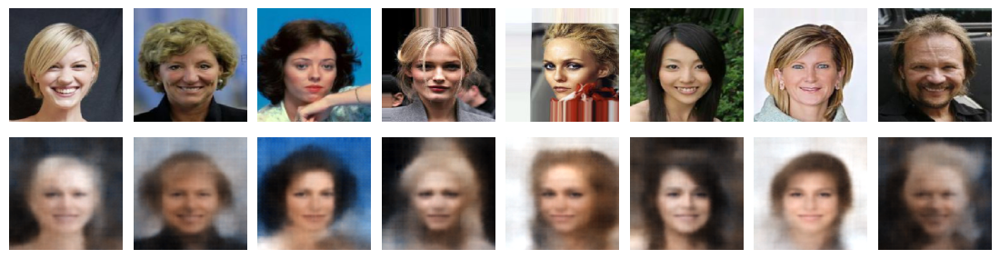

In [12]:
NUM_IMAGES = data_flow.samples
N_EPOCHS = 2
BATCH_SIZE = 128

vae.fit(data_flow, 
        shuffle=True, 
        epochs = N_EPOCHS, 
        initial_epoch = 0, 
        steps_per_epoch=NUM_IMAGES / BATCH_SIZE,
       verbose = 0)

example_batch = next(data_flow)
example_batch = example_batch[0]
example_images = example_batch[:8]
plot_compare_VAE(example_images)

Compiling and training using given losses over **10 iterations**:

Epoch 1/2
1582/1582 [==============================] - 185s 116ms/step - batch: 791.0000 - size: 32.0000 - loss: 228.1851 - r_loss: 0.0166 - kl_loss: 62.4935
Epoch 2/2
1582/1582 [==============================] - 184s 116ms/step - batch: 791.0000 - size: 32.0000 - loss: 218.5248 - r_loss: 0.0157 - kl_loss: 61.8860


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


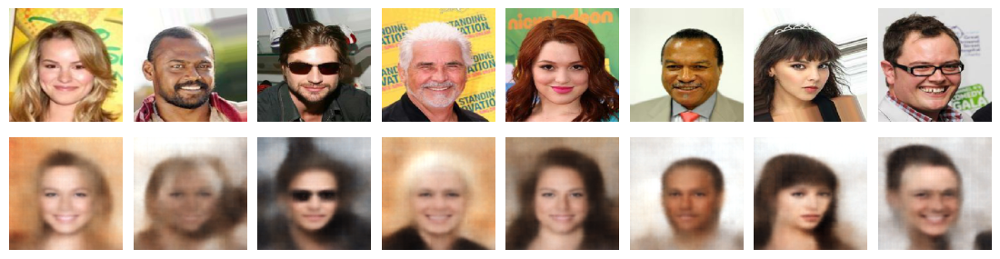

Epoch 1/2
1582/1582 [==============================] - 186s 117ms/step - batch: 791.0000 - size: 32.0000 - loss: 214.5054 - r_loss: 0.0153 - kl_loss: 61.8738
Epoch 2/2
1582/1582 [==============================] - 185s 117ms/step - batch: 791.0000 - size: 31.9842 - loss: 211.4177 - r_loss: 0.0150 - kl_loss: 61.6722


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


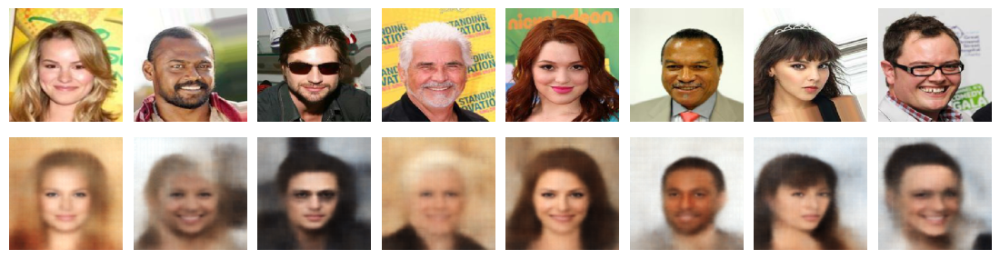

Epoch 1/2
1582/1582 [==============================] - 185s 117ms/step - batch: 791.0000 - size: 31.9842 - loss: 209.6856 - r_loss: 0.0148 - kl_loss: 61.6053
Epoch 2/2
1582/1582 [==============================] - 184s 116ms/step - batch: 791.0000 - size: 32.0000 - loss: 207.8658 - r_loss: 0.0146 - kl_loss: 61.4018


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


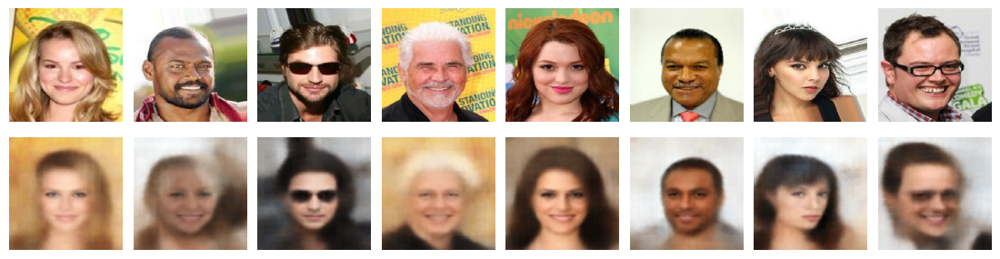

Epoch 1/2
1582/1582 [==============================] - 185s 117ms/step - batch: 791.0000 - size: 32.0000 - loss: 206.3919 - r_loss: 0.0145 - kl_loss: 61.4384
Epoch 2/2
1582/1582 [==============================] - 185s 117ms/step - batch: 791.0000 - size: 32.0000 - loss: 205.4635 - r_loss: 0.0144 - kl_loss: 61.4336


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


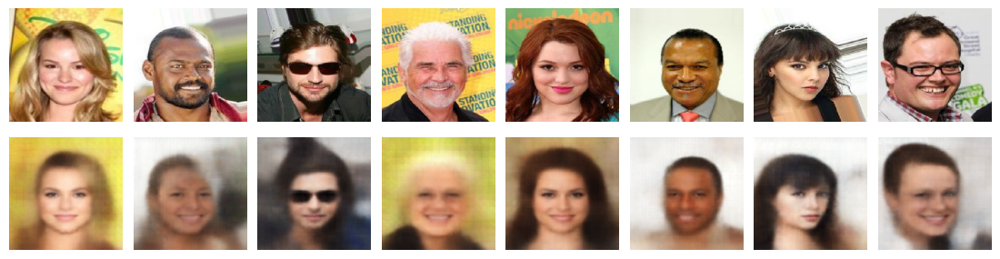

Epoch 1/2
1582/1582 [==============================] - 184s 116ms/step - batch: 791.0000 - size: 32.0000 - loss: 203.7929 - r_loss: 0.0142 - kl_loss: 61.3672
Epoch 2/2
1582/1582 [==============================] - 184s 116ms/step - batch: 791.0000 - size: 32.0000 - loss: 203.4691 - r_loss: 0.0142 - kl_loss: 61.4813


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


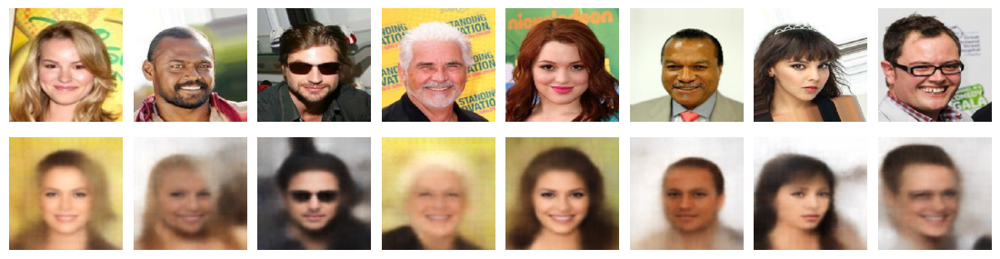

Epoch 1/2
1582/1582 [==============================] - 183s 116ms/step - batch: 791.0000 - size: 31.9842 - loss: 202.3487 - r_loss: 0.0141 - kl_loss: 61.5031
Epoch 2/2
1582/1582 [==============================] - 183s 116ms/step - batch: 791.0000 - size: 32.0000 - loss: 201.4276 - r_loss: 0.0140 - kl_loss: 61.5060


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


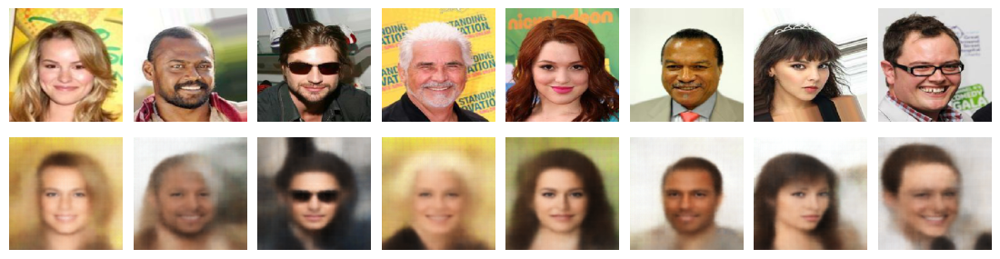

Epoch 1/2
1582/1582 [==============================] - 183s 116ms/step - batch: 791.0000 - size: 32.0000 - loss: 201.4209 - r_loss: 0.0140 - kl_loss: 61.6552
Epoch 2/2
1582/1582 [==============================] - 183s 116ms/step - batch: 791.0000 - size: 32.0000 - loss: 200.7302 - r_loss: 0.0139 - kl_loss: 61.5716


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


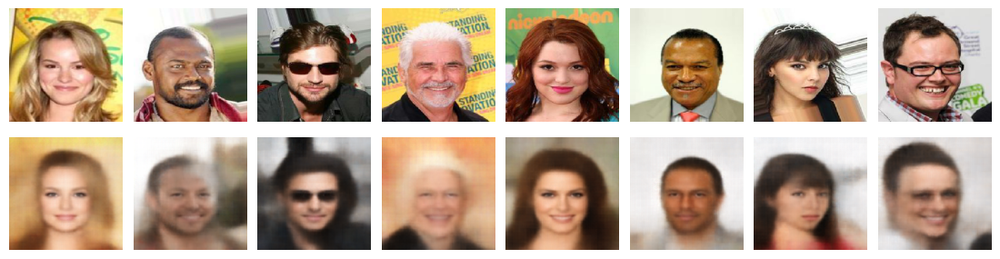

Epoch 1/2
1582/1582 [==============================] - 184s 116ms/step - batch: 791.0000 - size: 31.9842 - loss: 199.9021 - r_loss: 0.0138 - kl_loss: 61.4485
Epoch 2/2
1582/1582 [==============================] - 184s 117ms/step - batch: 791.0000 - size: 32.0000 - loss: 199.6669 - r_loss: 0.0138 - kl_loss: 61.5474


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


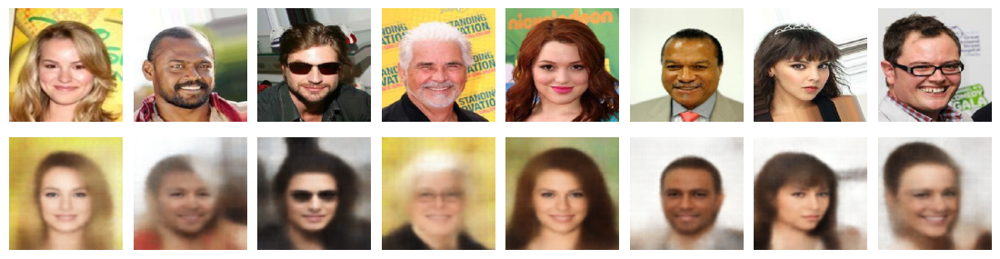

Epoch 1/2
1582/1582 [==============================] - 184s 116ms/step - batch: 791.0000 - size: 31.9842 - loss: 198.9805 - r_loss: 0.0137 - kl_loss: 61.6133
Epoch 2/2
1582/1582 [==============================] - 184s 116ms/step - batch: 791.0000 - size: 32.0000 - loss: 198.8736 - r_loss: 0.0137 - kl_loss: 61.5619


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


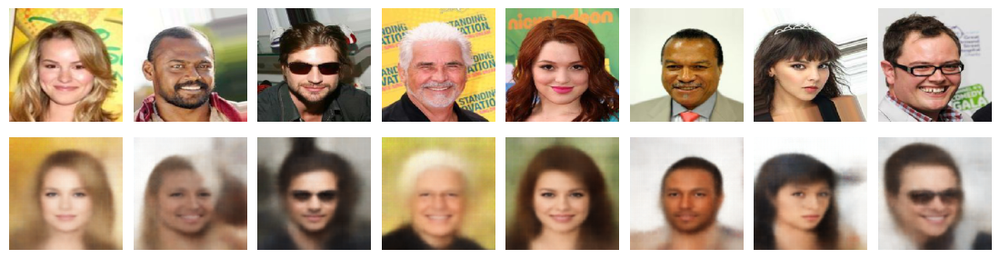

Epoch 1/2
1582/1582 [==============================] - 184s 116ms/step - batch: 791.0000 - size: 31.9842 - loss: 198.3789 - r_loss: 0.0137 - kl_loss: 61.6928
Epoch 2/2
1582/1582 [==============================] - 184s 116ms/step - batch: 791.0000 - size: 32.0000 - loss: 197.8938 - r_loss: 0.0136 - kl_loss: 61.6289


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


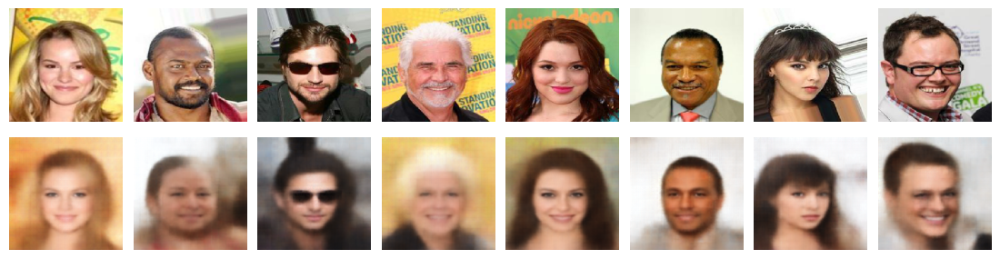

In [18]:
LEARNING_RATE = 0.0005
N_EPOCHS = 2  # No. of epochs to show advance
N_BLOCKS = 10
LOSS_FACTOR = 10000

adam_optimizer = Adam(learning_rate = LEARNING_RATE)
vae.compile(optimizer=adam_optimizer, loss = total_loss, metrics = [r_loss, kl_loss])

example_batch = next(data_flow)
example_batch = example_batch[0]
example_images = example_batch[:8]

for i in range(N_BLOCKS):
    vae.fit(data_flow, 
        shuffle=True, 
        epochs = N_EPOCHS, 
        initial_epoch = 0, 
        steps_per_epoch=NUM_IMAGES / BATCH_SIZE)
    plot_compare_VAE(example_images) 


### Playing with VAE to improve results

On this second attempt, we try to reduce strides to 1 in the convolutional layer to increase the resolution, and instead use MaxPooling2D layers to reduce the size of the output space on each layer. This changes affect only the raw part of the encoder, the sampling function part and the decoder remains the same. By incorporating MaxPooling2D layers and reducing the strides to 1, the encoder can learn a more robust and expressive representation of the input data. This attempt aims to capture finer details and preserve more information in the latent space.  

Shape before flattening: (16, 16, 512)
Epoch 1/2


2023-05-22 01:25:23.521862: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:939] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-05-22 01:25:23.522003: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:939] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-05-22 01:25:23.522072: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:939] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-05-22 01:25:23.522174: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:939] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-05-22 01:25:23.522245: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:939] successful NUMA node read from S

6331/6331 [==============================] - 1091s 172ms/step - batch: 3165.5000 - size: 31.9961 - loss: 0.0121
Epoch 2/2
6331/6331 [==============================] - 1088s 172ms/step - batch: 3165.5000 - size: 31.9961 - loss: 0.0059


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


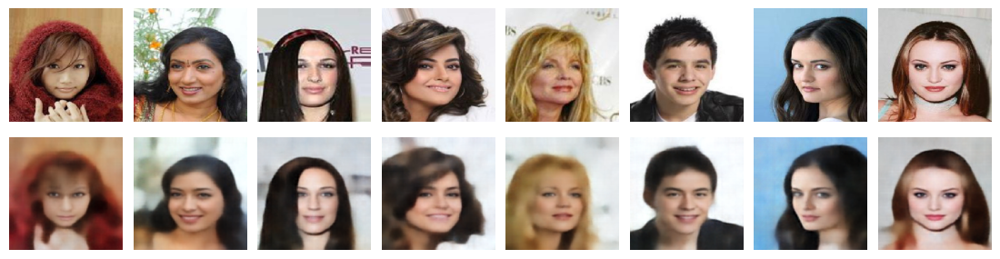

In [44]:
LATENT_DIM = 256

# Clear the TensorFlow backend session
K.clear_session()

# --------------------
# Building the encoder
# --------------------

encoder_input = Input(shape=(256, 256, 3))

x = Conv2D(64, kernel_size=3, strides=1, padding="same", activation="relu")(encoder_input)
x = MaxPooling2D(pool_size=2)(x)

x = Conv2D(128, kernel_size=3, strides=1, padding="same", activation="relu")(x)
x = MaxPooling2D(pool_size=2)(x)

x = Conv2D(256, kernel_size=3, strides=1, padding="same", activation="relu")(x)
x = MaxPooling2D(pool_size=2)(x)

x = Conv2D(512, kernel_size=3, strides=1, padding="same", activation="relu")(x)
x = MaxPooling2D(pool_size=2)(x)

shape_before_flattening = K.int_shape(x)[1:]
x = Flatten()(x)

# Mean and variance of the latent distribution
mean_mu = Dense(LATENT_DIM, name='mu')(x)
log_var = Dense(LATENT_DIM, name='log_var')(x)

def sampling(args):
    mean_mu, log_var = args
    epsilon = K.random_normal(shape=K.shape(mean_mu), mean=0., stddev=1.)
    return mean_mu + K.exp(log_var/2) * epsilon

encoder_output = Lambda(sampling, name='encoder_output')([mean_mu, log_var])

# Add GlobalAvgPooling layer


print(f"Shape before flattening: {shape_before_flattening}")

# --------------------
# Building the decoder
# --------------------

decoder_input = Input(shape=(LATENT_DIM,))
x = Dense(np.prod(shape_before_flattening), activation="relu")(decoder_input)
x = Reshape(shape_before_flattening)(x)  # Conv2DTranspose expects a 3D input tensor

# Add upsampling using Conv2DTranspose
x = Conv2DTranspose(256, kernel_size=3, strides=2, padding="same", activation="relu")(x)
x = Conv2DTranspose(128, kernel_size=3, strides=2, padding="same", activation="relu")(x)
x = Conv2DTranspose(64, kernel_size=3, strides=2, padding="same", activation="relu")(x)

# Add Conv2DTranspose for image reconstruction
x = Conv2DTranspose(3, kernel_size=3, strides=2, padding="same", activation="relu")(x)

decoder_output = x

# --------------------
# Full autoencoder
# --------------------

vae_encoder = Model(encoder_input, encoder_output)
vae_decoder = Model(decoder_input, decoder_output)

vae_input = encoder_input
vae_output = vae_decoder(encoder_output)

# Input to the combined model will be the input to the encoder.
# Output of the combined model will be the output of the decoder.
vae = Model(vae_input, vae_output)

# Define loss function after creating the models
def r_loss(y_true, y_pred):
    return K.mean(K.square(y_true - y_pred), axis=[1,2,3])

# Compile the model with the loss function
vae.compile(optimizer='adam', loss=r_loss)

LEARNING_RATE = 0.0005
N_EPOCHS = 2  # No. of epochs to show advance
N_BLOCKS = 1
LOSS_FACTOR = 10000

adam_optimizer = Adam(learning_rate=LEARNING_RATE)
vae.compile(optimizer=adam_optimizer, loss=r_loss)

example_batch = next(data_flow)
example_batch = example_batch[0]
example_images = example_batch[:8]

for i in range(N_BLOCKS):
    vae.fit(data_flow, 
            shuffle=True, 
            epochs=N_EPOCHS, 
            initial_epoch=0, 
            steps_per_epoch=NUM_IMAGES / BATCH_SIZE)
    plot_compare_VAE(example_images)


## GANs training

For to train the GANs, kernel must be reloaded and imports made again, this time without eager execution disabled. This is because a lot of tensorflow functionalities are not avaliable with eager execution disabled. 

In [1]:
%load_ext autoreload
%autoreload 2

import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import tensorflow as tf
from tensorflow.keras.layers import Input, Dense, Flatten, Reshape, Conv2D, Conv2DTranspose, Lambda, MaxPooling2D, GlobalAvgPool2D
from tensorflow.keras.models import Model
from tensorflow.keras import backend as K
from tensorflow.keras.optimizers import Adam
from tensorflow.keras import layers, models, callbacks, utils, metrics, optimizers

# Avoiding errors with sampling function by deactivation eager execution
# eager execution executes tensorflow operations inmediatly, once deactivated, 
# relies on a graph to compute them in a certain order
from tensorflow.python.framework.ops import disable_eager_execution, enable_eager_execution


import numpy as np
import matplotlib.pyplot as plt

global K
K.clear_session()

#### Parameters

In [2]:
IMAGE_SIZE = 64
CHANNELS = 3

BATCH_SIZE = 64
NUM_FEATURES = 128
Z_DIM = 128


EPOCHS = 900
STEPS_PER_EPOCH=1500


LEARNING_RATE = 0.0002
CRITIC_STEPS = 3

ADAM_BETA_1 = 0.5
ADAM_BETA_2 = 0.999

GP_WEIGHT = 10.0
LOAD_MODEL = False
ADAM_BETA_1 = 0.5
ADAM_BETA_2 = 0.9

#### Preparing the data

In [94]:
# Load the data
DATASET_PATH = "/home/kirle/Master/2cuatrimestre/Deep Learning/Practice/Lab5 - GANs/Dataset/archive/img_align_celeba"

train_data = tf.keras.utils.image_dataset_from_directory(
    DATASET_PATH,
    labels=None,
    color_mode="rgb",
    image_size=(IMAGE_SIZE, IMAGE_SIZE),
    batch_size=BATCH_SIZE,
    shuffle=True,
    seed=42,
    interpolation="bilinear",
)
# Repeat the dataset
train_data = train_data.repeat()

Found 202599 files belonging to 1 classes.


In [95]:
# Preprocess the data
def preprocess(img):
    """
    Normalize and reshape the images
    """
    img = (tf.cast(img, "float32") - 127.5) / 127.5
    return img


train = train_data.map(lambda x: preprocess(x))

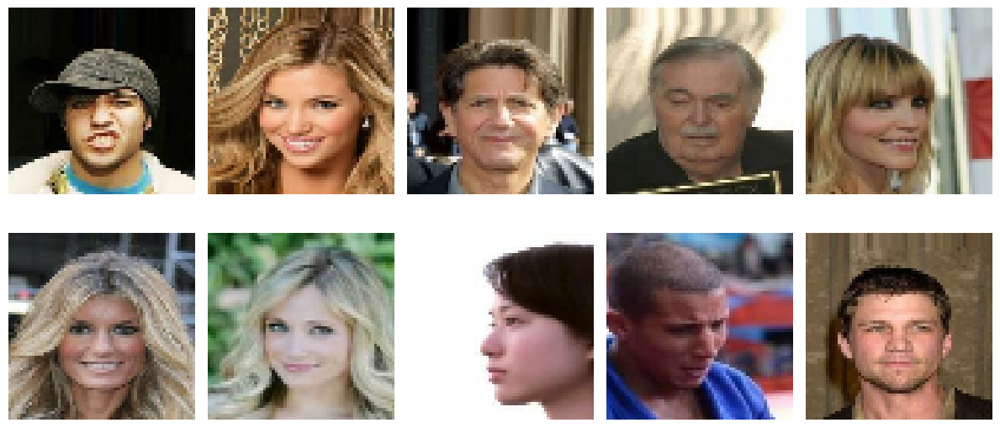

In [5]:
sample_images = next(iter(train_data))
fig, axes = plt.subplots(2, 5, figsize=(12, 6))
axes = axes.ravel()

for i in range(10):
    axes[i].imshow(sample_images[i].numpy().astype("uint8"))
    axes[i].axis("off")

plt.tight_layout()
plt.show()

#### Building the WGAN-GP

A deep convolutional GAN was built here. The critic is a combination of Conv2D layers using LeakyReLU as activation functions and Dropout layers to avoid the previously mentioned problems. 

In [96]:
critic_input = layers.Input(shape=(IMAGE_SIZE, IMAGE_SIZE, CHANNELS))
x = layers.Conv2D(64, kernel_size=4, strides=2, padding="same")(critic_input)
x = layers.LeakyReLU(0.2)(x)
x = layers.Conv2D(128, kernel_size=4, strides=2, padding="same")(x)
x = layers.LeakyReLU()(x)
x = layers.Dropout(0.3)(x)
x = layers.Conv2D(256, kernel_size=4, strides=2, padding="same")(x)
x = layers.LeakyReLU(0.2)(x)
x = layers.Dropout(0.3)(x)
x = layers.Conv2D(512, kernel_size=4, strides=2, padding="same")(x)
x = layers.LeakyReLU(0.2)(x)
x = layers.Dropout(0.3)(x)
x = layers.Conv2D(1, kernel_size=4, strides=1, padding="valid")(x)
critic_output = layers.Flatten()(x)

critic = models.Model(critic_input, critic_output)
critic.summary()

Model: "model_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_5 (InputLayer)        [(None, 64, 64, 3)]       0         
                                                                 
 conv2d_14 (Conv2D)          (None, 32, 32, 64)        3136      
                                                                 
 leaky_re_lu_20 (LeakyReLU)  (None, 32, 32, 64)        0         
                                                                 
 conv2d_15 (Conv2D)          (None, 16, 16, 128)       131200    
                                                                 
 leaky_re_lu_21 (LeakyReLU)  (None, 16, 16, 128)       0         
                                                                 
 dropout_6 (Dropout)         (None, 16, 16, 128)       0         
                                                                 
 conv2d_16 (Conv2D)          (None, 8, 8, 256)         5245

The generator architecture consists of a series of transposed convolutional layers with increasing numbers of filters and decreasing spatial dimensions. Batch normalization is applied after each convolutional layer to stabilize and accelerate training. Leaky ReLU activation function is used to introduce non-linearity and prevent gradient vanishing. Final convolutional layer maps the learned representations to the desired output channels with a hyperbolic tangent activation function.

In [97]:
generator_input = layers.Input(shape=(Z_DIM,))
x = layers.Reshape((1, 1, Z_DIM))(generator_input)
x = layers.Conv2DTranspose(512, kernel_size=4, strides=1, padding="valid", use_bias=False)(x)
x = layers.BatchNormalization(momentum=0.9)(x)
x = layers.LeakyReLU(0.2)(x)
x = layers.Conv2DTranspose(256, kernel_size=4, strides=2, padding="same", use_bias=False)(x)
x = layers.BatchNormalization(momentum=0.9)(x)
x = layers.LeakyReLU(0.2)(x)
x = layers.Conv2DTranspose(128, kernel_size=4, strides=2, padding="same", use_bias=False)(x)
x = layers.BatchNormalization(momentum=0.9)(x)
x = layers.LeakyReLU(0.2)(x)
x = layers.Conv2DTranspose(64, kernel_size=4, strides=2, padding="same", use_bias=False)(x)
x = layers.BatchNormalization(momentum=0.9)(x)
x = layers.LeakyReLU(0.2)(x)
generator_output = layers.Conv2DTranspose(CHANNELS, kernel_size=4, strides=2, padding="same", activation="tanh")(x)
generator = models.Model(generator_input, generator_output)
generator.summary()

Model: "model_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_6 (InputLayer)        [(None, 128)]             0         
                                                                 
 reshape_2 (Reshape)         (None, 1, 1, 128)         0         
                                                                 
 conv2d_transpose_10 (Conv2D  (None, 4, 4, 512)        1048576   
 Transpose)                                                      
                                                                 
 batch_normalization_12 (Bat  (None, 4, 4, 512)        2048      
 chNormalization)                                                
                                                                 
 leaky_re_lu_24 (LeakyReLU)  (None, 4, 4, 512)         0         
                                                                 
 conv2d_transpose_11 (Conv2D  (None, 8, 8, 256)        2097

In [98]:
class WGANGP(models.Model):
    def __init__(self, critic, generator, latent_dim, critic_steps, gp_weight):
        super(WGANGP, self).__init__()
        self.critic = critic
        self.generator = generator
        self.latent_dim = latent_dim
        self.critic_steps = critic_steps
        self.gp_weight = gp_weight

    def compile(self, c_optimizer, g_optimizer):
        super(WGANGP, self).compile()
        self.c_optimizer = c_optimizer
        self.g_optimizer = g_optimizer
        self.c_wass_loss_metric = metrics.Mean(name="c_wass_loss")
        self.c_gp_metric = metrics.Mean(name="c_gp")
        self.c_loss_metric = metrics.Mean(name="c_loss")
        self.g_loss_metric = metrics.Mean(name="g_loss")

    @property
    def metrics(self):
        return [self.c_loss_metric, self.c_wass_loss_metric, self.c_gp_metric, self.g_loss_metric]

    def gradient_penalty(self, batch_size, real_images, fake_images):
        alpha = tf.random.normal([batch_size, 1, 1, 1], 0.0, 1.0)
        diff = fake_images - real_images
        interpolated = real_images + alpha * diff

        with tf.GradientTape() as gp_tape:
            gp_tape.watch(interpolated)
            pred = self.critic(interpolated, training=True)

        grads = gp_tape.gradient(pred, [interpolated])[0]
        norm = tf.sqrt(tf.reduce_sum(tf.square(grads), axis=[1, 2, 3]))
        gp = tf.reduce_mean((norm - 1.0) ** 2)
        return gp

    def train_step(self, real_images):
        batch_size = tf.shape(real_images)[0]

        for i in range(self.critic_steps):
            random_latent_vectors = tf.random.normal(shape=(batch_size, self.latent_dim))

            with tf.GradientTape() as tape:
                fake_images = self.generator(random_latent_vectors, training=True)
                fake_predictions = self.critic(fake_images, training=True)
                real_predictions = self.critic(real_images, training=True)

                c_wass_loss = tf.reduce_mean(fake_predictions) - tf.reduce_mean(real_predictions)
                c_gp = self.gradient_penalty(batch_size, real_images, fake_images)
                c_loss = c_wass_loss + c_gp * self.gp_weight

            c_gradient = tape.gradient(c_loss, self.critic.trainable_variables)
            self.c_optimizer.apply_gradients(zip(c_gradient, self.critic.trainable_variables))

        random_latent_vectors = tf.random.normal(shape=(batch_size, self.latent_dim))
        with tf.GradientTape() as tape:
            fake_images = self.generator(random_latent_vectors, training=True)
            fake_predictions = self.critic(fake_images, training=True)
            g_loss = -tf.reduce_mean(fake_predictions)

        gen_gradient = tape.gradient(g_loss, self.generator.trainable_variables)
        self.g_optimizer.apply_gradients(zip(gen_gradient, self.generator.trainable_variables))

        """
        self.c_loss_metric.update_state(c_loss)
        self.c_wass_loss_metric.update_state(c_wass_loss)
        self.c_gp_metric.update_state(c_gp)
        self.g_loss_metric.update_state(g_loss)

        return {m.name: m.result() for m in self.metrics}
        """
    
      # Calculate Critic and Generator Accuracy
        c_acc = tf.reduce_mean(tf.cast(tf.math.greater(real_predictions, 0), tf.float32)) * 100
        g_acc = tf.reduce_mean(tf.cast(tf.math.less(fake_predictions, 0), tf.float32)) * 100

        self.c_loss_metric.update_state(c_loss)
        self.c_wass_loss_metric.update_state(c_wass_loss)
        self.c_gp_metric.update_state(c_gp)
        self.g_loss_metric.update_state(g_loss)

        #return {m.name: m.result() for m in self.metrics,'c_acc': c_acc,'g_acc': g_acc}    
        return {**{m.name: m.result() for m in self.metrics}, 'c_acc': c_acc, 'g_acc': g_acc}
    

Mixing parts together:

In [99]:
# Create a GAN
wgangp = WGANGP(critic=critic, generator=generator, latent_dim=Z_DIM, critic_steps=CRITIC_STEPS, gp_weight=GP_WEIGHT)

In [10]:
#LOAD_MODEL = True

if LOAD_MODEL:
    wgangp.load_weights("./checkpoint/checkpoint.ckpt")

#### Train the GAN

In [100]:
# Compile the GAN
wgangp.compile(
    c_optimizer=optimizers.Adam(learning_rate=LEARNING_RATE, beta_1=ADAM_BETA_1, beta_2=ADAM_BETA_2),
    g_optimizer=optimizers.Adam(learning_rate=LEARNING_RATE, beta_1=ADAM_BETA_1, beta_2=ADAM_BETA_2),
)

Two callbacks were defined. Image generator saves images at the end of each epoch, and LossHistory records and stores the loss and accuracy values at the end of each epoch.

In [101]:
# Create a model save checkpoint
model_checkpoint_callback = callbacks.ModelCheckpoint(
    filepath="./checkpoint/checkpoint.ckpt",
    save_weights_only=True,
    save_freq="epoch",
    verbose=0,
)

tensorboard_callback = callbacks.TensorBoard(log_dir="./logs")


class ImageGenerator(callbacks.Callback):
    def __init__(self, num_img, latent_dim):
        self.num_img = num_img
        self.latent_dim = latent_dim

    def on_epoch_end(self, epoch, logs=None):
        random_latent_vectors = tf.random.normal(shape=(self.num_img, self.latent_dim))
        generated_images = self.model.generator(random_latent_vectors)
        generated_images = generated_images * 127.5 + 127.5
        generated_images = generated_images.numpy()
        from utils import display
        display(generated_images, save_to="./output/generated_img_%03d.png" % (epoch), cmap=None)

class LossHistory(callbacks.Callback):
    def on_train_begin(self, logs=None):
        self.history = {
            'c_loss': [],
            'g_loss': [],
            'c_acc': [],
            'g_acc': [],
        }

    def on_epoch_end(self, epoch, logs=None):
        self.history['c_loss'].append(logs['c_loss'])
        self.history['g_loss'].append(logs['g_loss'])
        self.history['c_acc'].append(logs['c_acc'])
        self.history['g_acc'].append(logs['g_acc'])

loss_history = LossHistory()

We have trained over just 30 epochs due to computing limitations. Results are not pretty good, but gives us an idea of how the evolution should be.

Epoch 1/30
1500/1500 [==============================] - ETA: 0s - c_loss: -11.4417 - c_wass_loss: -14.0832 - c_gp: 0.2642 - g_loss: -34.4637 - c_acc: 90.3563 - g_acc: 17.9281
Saved to ./output/generated_img_000.png


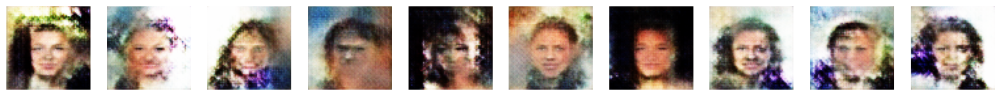

1500/1500 [==============================] - 202s 133ms/step - c_loss: -11.4417 - c_wass_loss: -14.0832 - c_gp: 0.2642 - g_loss: -34.4637 - c_acc: 90.3408 - g_acc: 17.9432
Epoch 2/30
1500/1500 [==============================] - ETA: 0s - c_loss: -4.5460 - c_wass_loss: -5.0715 - c_gp: 0.0526 - g_loss: -33.9006 - c_acc: 75.6917 - g_acc: 27.1052
Saved to ./output/generated_img_001.png


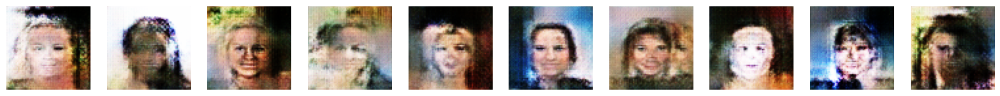

1500/1500 [==============================] - 200s 133ms/step - c_loss: -4.5460 - c_wass_loss: -5.0715 - c_gp: 0.0526 - g_loss: -33.9006 - c_acc: 75.7058 - g_acc: 27.0903
Epoch 3/30
1500/1500 [==============================] - ETA: 0s - c_loss: -3.5925 - c_wass_loss: -3.9903 - c_gp: 0.0398 - g_loss: -22.8240 - c_acc: 66.3139 - g_acc: 37.3202
Saved to ./output/generated_img_002.png


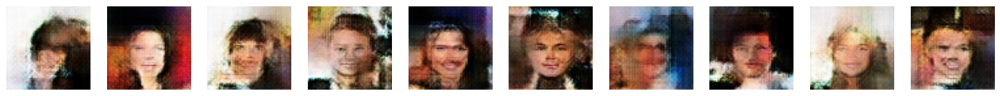

1500/1500 [==============================] - 199s 133ms/step - c_loss: -3.5925 - c_wass_loss: -3.9903 - c_gp: 0.0398 - g_loss: -22.8240 - c_acc: 66.2895 - g_acc: 37.3463
Epoch 4/30
1500/1500 [==============================] - ETA: 0s - c_loss: -3.8932 - c_wass_loss: -4.2584 - c_gp: 0.0365 - g_loss: 13.2250 - c_acc: 48.1031 - g_acc: 55.8896
Saved to ./output/generated_img_003.png


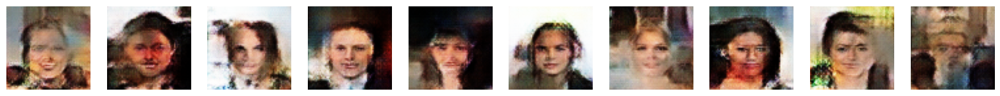

1500/1500 [==============================] - 200s 133ms/step - c_loss: -3.8932 - c_wass_loss: -4.2584 - c_gp: 0.0365 - g_loss: 13.2250 - c_acc: 48.0804 - g_acc: 55.9065
Epoch 5/30
1500/1500 [==============================] - ETA: 0s - c_loss: -3.0948 - c_wass_loss: -3.4324 - c_gp: 0.0338 - g_loss: 46.1483 - c_acc: 27.0898 - g_acc: 75.3513
Saved to ./output/generated_img_004.png


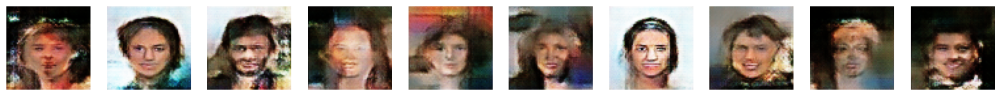

1500/1500 [==============================] - 200s 133ms/step - c_loss: -3.0948 - c_wass_loss: -3.4324 - c_gp: 0.0338 - g_loss: 46.1483 - c_acc: 27.0894 - g_acc: 75.3615
Epoch 6/30
1500/1500 [==============================] - ETA: 0s - c_loss: -2.6569 - c_wass_loss: -2.9997 - c_gp: 0.0343 - g_loss: 125.3352 - c_acc: 31.9125 - g_acc: 68.7615
Saved to ./output/generated_img_005.png


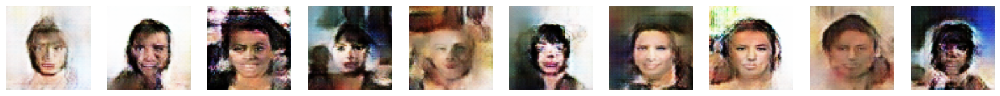

1500/1500 [==============================] - 200s 133ms/step - c_loss: -2.6569 - c_wass_loss: -2.9997 - c_gp: 0.0343 - g_loss: 125.3352 - c_acc: 31.9370 - g_acc: 68.7333
Epoch 7/30
1500/1500 [==============================] - ETA: 0s - c_loss: -3.2996 - c_wass_loss: -3.5784 - c_gp: 0.0279 - g_loss: -0.3164 - c_acc: 52.5517 - g_acc: 47.9357
Saved to ./output/generated_img_006.png


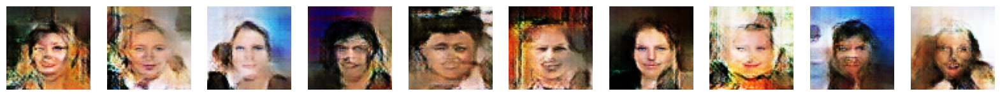

1500/1500 [==============================] - 200s 133ms/step - c_loss: -3.2996 - c_wass_loss: -3.5784 - c_gp: 0.0279 - g_loss: -0.3164 - c_acc: 52.5323 - g_acc: 47.9652
Epoch 8/30
1500/1500 [==============================] - ETA: 0s - c_loss: -1.1710 - c_wass_loss: -1.4139 - c_gp: 0.0243 - g_loss: -36.6321 - c_acc: 72.4271 - g_acc: 28.2406
Saved to ./output/generated_img_007.png


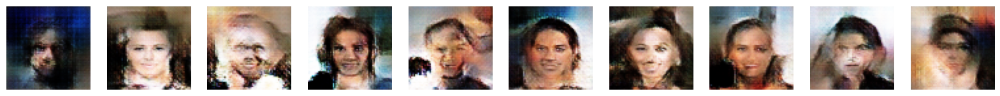

1500/1500 [==============================] - 200s 133ms/step - c_loss: -1.1710 - c_wass_loss: -1.4139 - c_gp: 0.0243 - g_loss: -36.6321 - c_acc: 72.4413 - g_acc: 28.2249
Epoch 9/30
1500/1500 [==============================] - ETA: 0s - c_loss: -1.9296 - c_wass_loss: -2.3019 - c_gp: 0.0372 - g_loss: 121.5714 - c_acc: 38.7094 - g_acc: 61.5323
Saved to ./output/generated_img_008.png


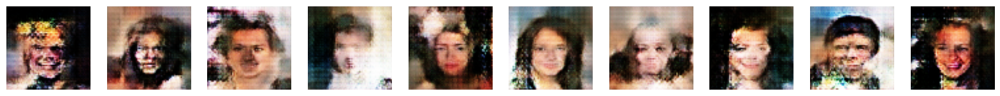

1500/1500 [==============================] - 199s 133ms/step - c_loss: -1.9296 - c_wass_loss: -2.3019 - c_gp: 0.0372 - g_loss: 121.5714 - c_acc: 38.6950 - g_acc: 61.5444
Epoch 10/30
1500/1500 [==============================] - ETA: 0s - c_loss: 1.2978 - c_wass_loss: 0.8234 - c_gp: 0.0474 - g_loss: 441.8480 - c_acc: 10.4177 - g_acc: 89.5698
Saved to ./output/generated_img_009.png


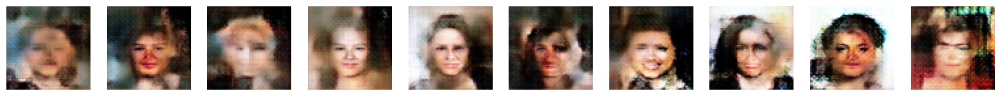

1500/1500 [==============================] - 200s 133ms/step - c_loss: 1.2978 - c_wass_loss: 0.8234 - c_gp: 0.0474 - g_loss: 441.8480 - c_acc: 10.4139 - g_acc: 89.5726
Epoch 11/30
1500/1500 [==============================] - ETA: 0s - c_loss: -5.4734 - c_wass_loss: -6.9002 - c_gp: 0.1427 - g_loss: 773.1099 - c_acc: 18.7755 - g_acc: 81.4107
Saved to ./output/generated_img_010.png


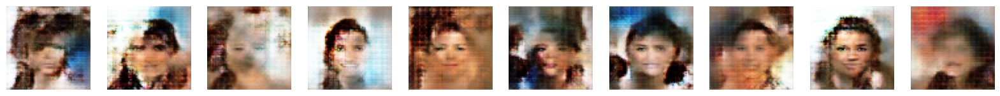

1500/1500 [==============================] - 199s 133ms/step - c_loss: -5.4734 - c_wass_loss: -6.9002 - c_gp: 0.1427 - g_loss: 773.1099 - c_acc: 18.7692 - g_acc: 81.4138
Epoch 12/30
1500/1500 [==============================] - ETA: 0s - c_loss: 2.1817 - c_wass_loss: 1.5566 - c_gp: 0.0625 - g_loss: 532.4033 - c_acc: 13.5969 - g_acc: 86.3969
Saved to ./output/generated_img_011.png


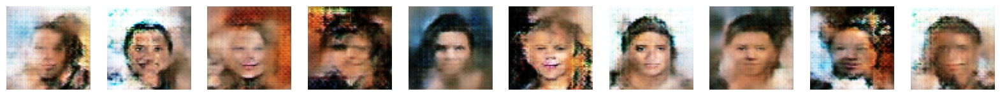

1500/1500 [==============================] - 200s 133ms/step - c_loss: 2.1817 - c_wass_loss: 1.5566 - c_gp: 0.0625 - g_loss: 532.4033 - c_acc: 13.6190 - g_acc: 86.3820
Epoch 13/30
1500/1500 [==============================] - ETA: 0s - c_loss: 1.3151 - c_wass_loss: 0.7011 - c_gp: 0.0614 - g_loss: 609.1124 - c_acc: 13.8943 - g_acc: 86.0091
Saved to ./output/generated_img_012.png


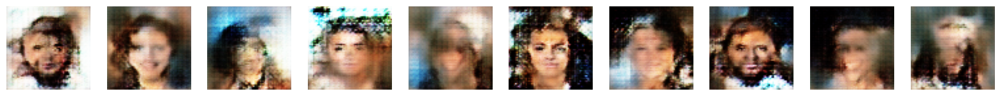

1500/1500 [==============================] - 200s 133ms/step - c_loss: 1.3151 - c_wass_loss: 0.7011 - c_gp: 0.0614 - g_loss: 609.1124 - c_acc: 13.8934 - g_acc: 86.0090
Epoch 14/30
1500/1500 [==============================] - ETA: 0s - c_loss: -0.0876 - c_wass_loss: -0.4058 - c_gp: 0.0318 - g_loss: -44.9790 - c_acc: 57.4000 - g_acc: 42.6948
Saved to ./output/generated_img_013.png


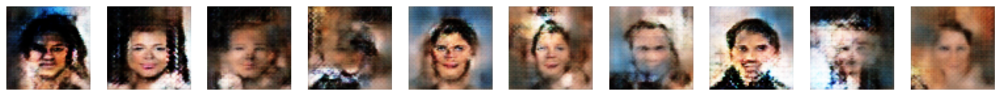

1500/1500 [==============================] - 200s 133ms/step - c_loss: -0.0876 - c_wass_loss: -0.4058 - c_gp: 0.0318 - g_loss: -44.9790 - c_acc: 57.4221 - g_acc: 42.6726
Epoch 15/30
1500/1500 [==============================] - ETA: 0s - c_loss: -0.9429 - c_wass_loss: -1.4456 - c_gp: 0.0503 - g_loss: -379.0992 - c_acc: 92.9667 - g_acc: 7.3163
Saved to ./output/generated_img_014.png


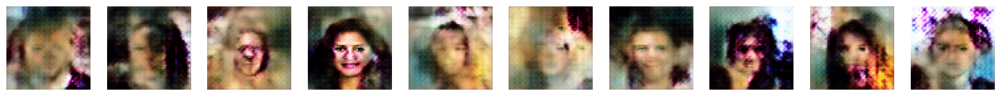

1500/1500 [==============================] - 199s 133ms/step - c_loss: -0.9429 - c_wass_loss: -1.4456 - c_gp: 0.0503 - g_loss: -379.0992 - c_acc: 92.9641 - g_acc: 7.3208
Epoch 16/30
1500/1500 [==============================] - ETA: 0s - c_loss: -8.5610 - c_wass_loss: -10.3154 - c_gp: 0.1754 - g_loss: -675.8558 - c_acc: 70.2052 - g_acc: 29.9833
Saved to ./output/generated_img_015.png


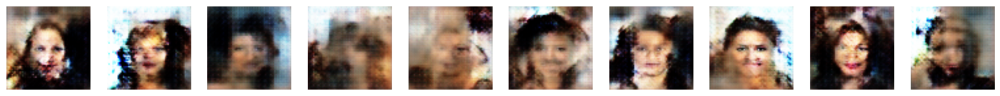

1500/1500 [==============================] - 200s 133ms/step - c_loss: -8.5610 - c_wass_loss: -10.3154 - c_gp: 0.1754 - g_loss: -675.8558 - c_acc: 70.2001 - g_acc: 29.9852
Epoch 17/30
1500/1500 [==============================] - ETA: 0s - c_loss: 3.3905 - c_wass_loss: 1.0003 - c_gp: 0.2390 - g_loss: -188.0464 - c_acc: 57.5781 - g_acc: 42.4646
Saved to ./output/generated_img_016.png


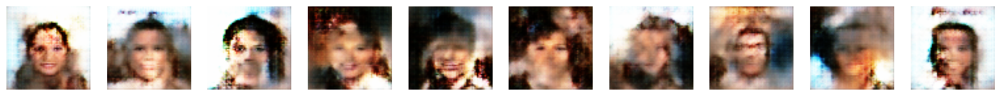

1500/1500 [==============================] - 198s 132ms/step - c_loss: 3.3905 - c_wass_loss: 1.0003 - c_gp: 0.2390 - g_loss: -188.0464 - c_acc: 57.5981 - g_acc: 42.4457
Epoch 18/30
1500/1500 [==============================] - ETA: 0s - c_loss: -3.1349 - c_wass_loss: -4.5122 - c_gp: 0.1377 - g_loss: -769.8597 - c_acc: 79.1979 - g_acc: 20.8333
Saved to ./output/generated_img_017.png


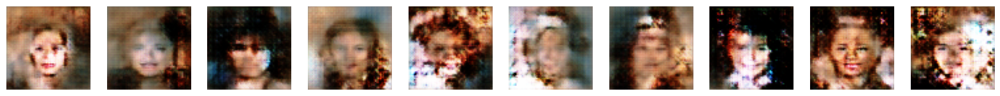

1500/1500 [==============================] - 199s 133ms/step - c_loss: -3.1349 - c_wass_loss: -4.5122 - c_gp: 0.1377 - g_loss: -769.8597 - c_acc: 79.1743 - g_acc: 20.8496
Epoch 19/30
1500/1500 [==============================] - ETA: 0s - c_loss: 4.8774 - c_wass_loss: 3.2523 - c_gp: 0.1625 - g_loss: 58.2409 - c_acc: 48.2165 - g_acc: 51.6061
Saved to ./output/generated_img_018.png


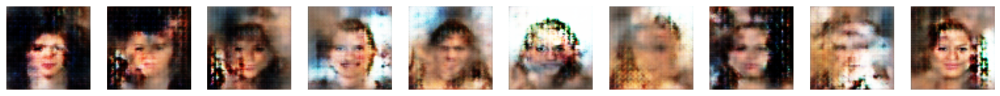

1500/1500 [==============================] - 198s 132ms/step - c_loss: 4.8774 - c_wass_loss: 3.2523 - c_gp: 0.1625 - g_loss: 58.2409 - c_acc: 48.2333 - g_acc: 51.5957
Epoch 20/30
1500/1500 [==============================] - ETA: 0s - c_loss: 10.8539 - c_wass_loss: 8.4374 - c_gp: 0.2416 - g_loss: -165.9709 - c_acc: 54.2135 - g_acc: 45.6969
Saved to ./output/generated_img_019.png


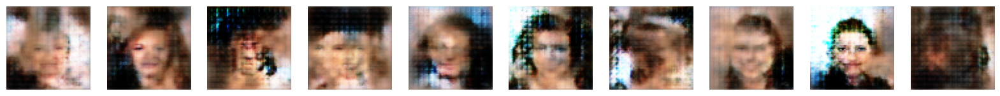

1500/1500 [==============================] - 199s 133ms/step - c_loss: 10.8539 - c_wass_loss: 8.4374 - c_gp: 0.2416 - g_loss: -165.9709 - c_acc: 54.2420 - g_acc: 45.6696
Epoch 21/30
1500/1500 [==============================] - ETA: 0s - c_loss: -2.0231 - c_wass_loss: -2.5044 - c_gp: 0.0481 - g_loss: 57.1924 - c_acc: 47.5604 - g_acc: 52.9760
Saved to ./output/generated_img_020.png


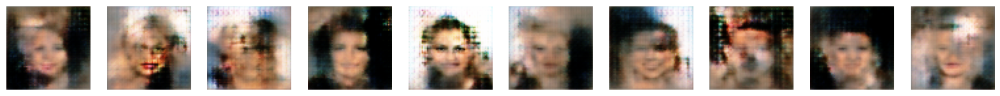

1500/1500 [==============================] - 200s 133ms/step - c_loss: -2.0231 - c_wass_loss: -2.5044 - c_gp: 0.0481 - g_loss: 57.1924 - c_acc: 47.5558 - g_acc: 52.9866
Epoch 22/30
1500/1500 [==============================] - ETA: 0s - c_loss: -0.3945 - c_wass_loss: -1.0380 - c_gp: 0.0644 - g_loss: 188.5033 - c_acc: 35.8723 - g_acc: 64.1926
Saved to ./output/generated_img_021.png


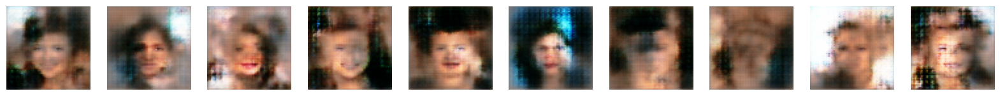

1500/1500 [==============================] - 199s 133ms/step - c_loss: -0.3945 - c_wass_loss: -1.0380 - c_gp: 0.0644 - g_loss: 188.5033 - c_acc: 35.9025 - g_acc: 64.1633
Epoch 23/30
1500/1500 [==============================] - ETA: 0s - c_loss: -0.4957 - c_wass_loss: -0.9827 - c_gp: 0.0487 - g_loss: 154.2952 - c_acc: 40.6292 - g_acc: 59.5562
Saved to ./output/generated_img_022.png


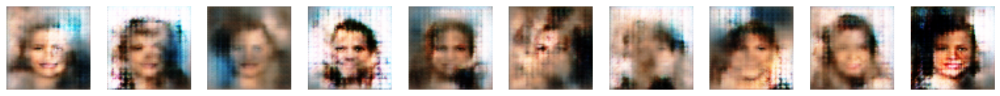

1500/1500 [==============================] - 199s 133ms/step - c_loss: -0.4957 - c_wass_loss: -0.9827 - c_gp: 0.0487 - g_loss: 154.2952 - c_acc: 40.6031 - g_acc: 59.5822
Epoch 24/30
1500/1500 [==============================] - ETA: 0s - c_loss: 0.6396 - c_wass_loss: 0.1937 - c_gp: 0.0446 - g_loss: 194.0440 - c_acc: 34.3180 - g_acc: 65.5972
Saved to ./output/generated_img_023.png


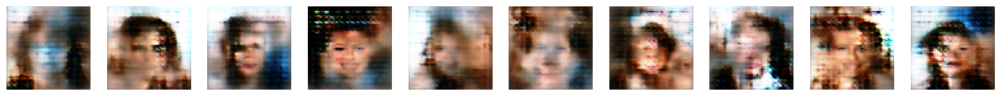

1500/1500 [==============================] - 200s 133ms/step - c_loss: 0.6396 - c_wass_loss: 0.1937 - c_gp: 0.0446 - g_loss: 194.0440 - c_acc: 34.2983 - g_acc: 65.6170
Epoch 25/30
1500/1500 [==============================] - ETA: 0s - c_loss: 0.4063 - c_wass_loss: -0.1641 - c_gp: 0.0570 - g_loss: 181.1617 - c_acc: 33.4031 - g_acc: 66.6698
Saved to ./output/generated_img_024.png


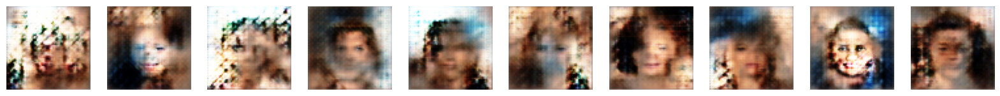

1500/1500 [==============================] - 200s 133ms/step - c_loss: 0.4063 - c_wass_loss: -0.1641 - c_gp: 0.0570 - g_loss: 181.1617 - c_acc: 33.3902 - g_acc: 66.6774
Epoch 26/30
1500/1500 [==============================] - ETA: 0s - c_loss: -0.3671 - c_wass_loss: -1.0415 - c_gp: 0.0674 - g_loss: 7.4503 - c_acc: 40.7802 - g_acc: 59.2073
Saved to ./output/generated_img_025.png


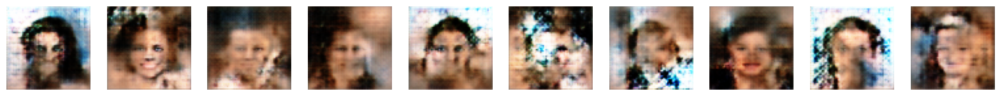

1500/1500 [==============================] - 199s 133ms/step - c_loss: -0.3671 - c_wass_loss: -1.0415 - c_gp: 0.0674 - g_loss: 7.4503 - c_acc: 40.8165 - g_acc: 59.1699
Epoch 27/30
1500/1500 [==============================] - ETA: 0s - c_loss: -1.0533 - c_wass_loss: -1.5760 - c_gp: 0.0523 - g_loss: -260.6841 - c_acc: 77.7875 - g_acc: 22.3823
Saved to ./output/generated_img_026.png


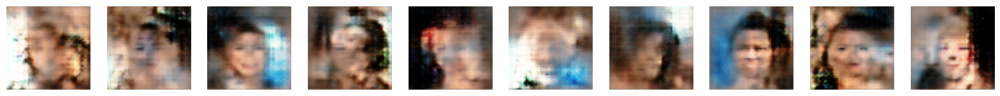

1500/1500 [==============================] - 199s 133ms/step - c_loss: -1.0533 - c_wass_loss: -1.5760 - c_gp: 0.0523 - g_loss: -260.6841 - c_acc: 77.7711 - g_acc: 22.4028
Epoch 28/30
1500/1500 [==============================] - ETA: 0s - c_loss: -0.7405 - c_wass_loss: -1.2154 - c_gp: 0.0475 - g_loss: -377.4503 - c_acc: 92.4053 - g_acc: 7.5920
Saved to ./output/generated_img_027.png


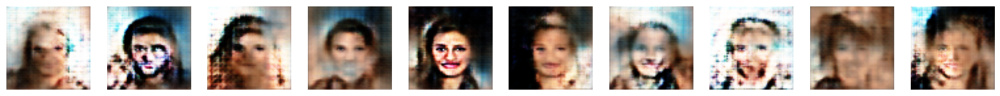

1500/1500 [==============================] - 199s 133ms/step - c_loss: -0.7405 - c_wass_loss: -1.2154 - c_gp: 0.0475 - g_loss: -377.4503 - c_acc: 92.4103 - g_acc: 7.5869
Epoch 29/30
1500/1500 [==============================] - ETA: 0s - c_loss: -1.1861 - c_wass_loss: -1.9769 - c_gp: 0.0791 - g_loss: -648.1026 - c_acc: 89.6708 - g_acc: 10.1729
Saved to ./output/generated_img_028.png


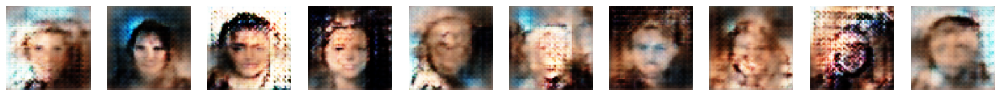

1500/1500 [==============================] - 199s 132ms/step - c_loss: -1.1861 - c_wass_loss: -1.9769 - c_gp: 0.0791 - g_loss: -648.1026 - c_acc: 89.6631 - g_acc: 10.1828
Epoch 30/30
1500/1500 [==============================] - ETA: 0s - c_loss: 1.9486 - c_wass_loss: 1.4515 - c_gp: 0.0497 - g_loss: -104.3674 - c_acc: 58.9609 - g_acc: 41.0057
Saved to ./output/generated_img_029.png


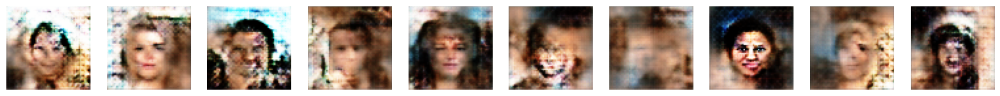

1500/1500 [==============================] - 199s 133ms/step - c_loss: 1.9486 - c_wass_loss: 1.4515 - c_gp: 0.0497 - g_loss: -104.3674 - c_acc: 58.9872 - g_acc: 40.9836


In [102]:
EPOCHS = 30
loss_history = LossHistory()

wgangp.fit(
    train,
    epochs=EPOCHS,
    steps_per_epoch=STEPS_PER_EPOCH,
    callbacks=[model_checkpoint_callback, tensorboard_callback, ImageGenerator(num_img=10, latent_dim=Z_DIM), loss_history],
)

In [103]:
# Save the final models
generator.save("./models/generator")
critic.save("./models/critic")

2023-05-22 10:06:45.640487: W tensorflow/python/util/util.cc:368] Sets are not currently considered sequences, but this may change in the future, so consider avoiding using them.


INFO:tensorflow:Assets written to: ./models/generator/assets
INFO:tensorflow:Assets written to: ./models/critic/assets


#### Generate images

Generating random images from random generated noise:

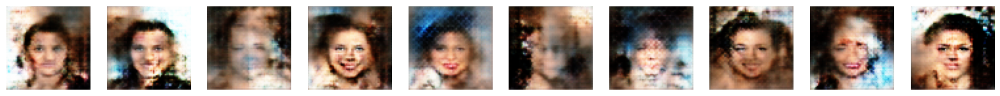

In [111]:
from utils import display
z_sample = np.random.normal(size=(10, Z_DIM))
generated_images = wgangp.generator.predict(z_sample)
display(generated_images, cmap=None)

Plotting training metrics evolution:

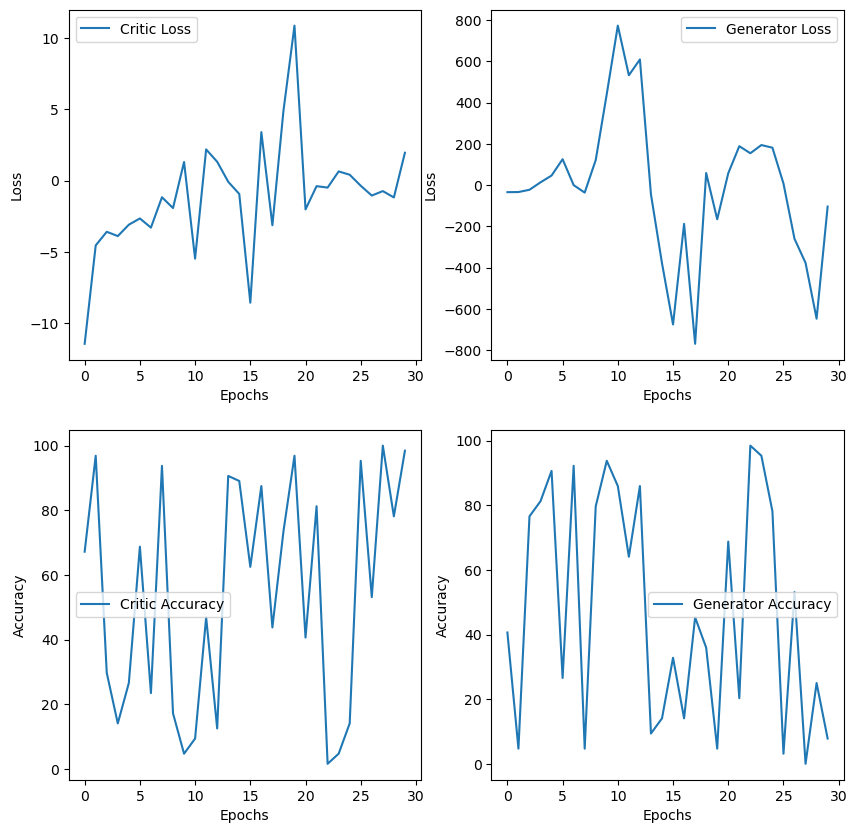

In [104]:
def plot_losses_and_accuracy(loss_history):
    epochs = len(loss_history.history['c_loss'])
    x = range(epochs)

    fig, axs = plt.subplots(2, 2, figsize=(10, 10))
    
    axs[0, 0].plot(x, loss_history.history['c_loss'], label="Critic Loss")
    axs[0, 0].set(xlabel="Epochs", ylabel="Loss")
    axs[0, 0].legend()
    
    axs[0, 1].plot(x, loss_history.history['g_loss'], label="Generator Loss")
    axs[0, 1].set(xlabel="Epochs", ylabel="Loss")
    axs[0, 1].legend()
    
    axs[1, 0].plot(x, loss_history.history['c_acc'], label="Critic Accuracy")
    axs[1, 0].set(xlabel="Epochs", ylabel="Accuracy")
    axs[1, 0].legend()
    
    axs[1, 1].plot(x, loss_history.history['g_acc'], label="Generator Accuracy")
    axs[1, 1].set(xlabel="Epochs", ylabel="Accuracy")
    axs[1, 1].legend()

    plt.show()

plot_losses_and_accuracy(loss_history)

Results show abrupt changes on critic and generator accuracy during training. This may indicate a possible mode collapsing problem, with the generator ignoring the diversity of the training data, or maybe that the hyperparameters for the architectures doen´t fit well.

#### Computing FID

Fréchet Inception Distance measures the similarity between the distribution of generated images and the distribution of real images using features extracted from a pre-trained convolutional neural network (Inception network).  

In [15]:
from numpy import cov, trace
from numpy.random import shuffle
from scipy.linalg import sqrtm
from skimage.transform import resize
from keras.applications.inception_v3 import InceptionV3
from keras.applications.inception_v3 import preprocess_input

In [16]:
def scale_images(images, new_shape):
    images_list = []
    for image in images:
        # Resize with nearest neighbor interpolation
        new_image = resize(image, new_shape, 0)
        # Store
        images_list.append(new_image)
    return np.asarray(images_list)

def calculate_fid(model, images1, images2):
    # Calculate activations
    act1 = model.predict(images1)
    act2 = model.predict(images2)
    
    # Calculate mean and covariance statistics
    mu1, sigma1 = act1.mean(axis=0), cov(act1, rowvar=False)
    mu2, sigma2 = act2.mean(axis=0), cov(act2, rowvar=False)
    
    # Calculate sum squared difference between means
    ssdiff = np.sum((mu1 - mu2) ** 2.0)
    
    # Calculate square root of the product between covariances
    covmean = sqrtm(sigma1.dot(sigma2))
    
    # Check and correct imaginary numbers from square root
    if np.iscomplexobj(covmean):
        covmean = covmean.real
    
    # Calculate FID score
    fid = ssdiff + trace(sigma1 + sigma2 - 2.0 * covmean)
    return fid


In [19]:
model = InceptionV3(include_top=False, pooling='avg', input_shape=(299, 299, 3))

# if i take more images, my computer crashes
n_samples = 100
train_images = []
for i, batch in enumerate(train_data):
    train_images.extend(batch.numpy())
    if (i + 1) * BATCH_SIZE >= n_samples:
        break
train_images = np.array(train_images[:n_samples])

# processing reference images
train_images = train_images.astype('float32')
train_images = scale_images(train_images, (299, 299, 3))
train_images = preprocess_input(train_images)

# processing generated images in same way
generated_images = generated_images.astype('float32')
generated_images = scale_images(generated_images, (299, 299, 3))
generated_images = preprocess_input(generated_images)

fid = calculate_fid(model, train_images, generated_images)
print('FID: %.3f' % fid)

FID: 503.697


### Improving GAN

To improve the generator network, a residual block was added. This way, the network has the potential to better capture complex patterns and dependencies in the data. Residual connections add a shortcut that directly propagates the input to the output of a block. The residual block was introduced after the first convolutional layer. The residual connection connects the output of the second convolutional layer to the output of the first convolutional layer before the activation function is applied. That way, the network can learn to adjust the output of the second convolutional layer based on the residual information from the first layer.


In [79]:
IMAGE_SIZE = 64
CHANNELS = 3

BATCH_SIZE = 64
NUM_FEATURES = 128
Z_DIM = 128


EPOCHS = 900
STEPS_PER_EPOCH=1500


LEARNING_RATE = 0.0002
CRITIC_STEPS = 3

ADAM_BETA_1 = 0.5
ADAM_BETA_2 = 0.999

GP_WEIGHT = 10.0
LOAD_MODEL = False
ADAM_BETA_1 = 0.5
ADAM_BETA_2 = 0.9

In [80]:
generator_input = layers.Input(shape=(Z_DIM,))
x = layers.Reshape((1, 1, Z_DIM))(generator_input)
x = layers.Conv2DTranspose(512, kernel_size=4, strides=1, padding="valid", use_bias=False)(x)
x = layers.BatchNormalization(momentum=0.9)(x)
x = layers.LeakyReLU(0.2)(x)

# Save the output for later
residual_1 = x

# Add additional convolutional layers for the residual block
x = layers.Conv2D(512, kernel_size=3, strides=1, padding="same")(x)
x = layers.BatchNormalization(momentum=0.9)(x)
x = layers.LeakyReLU(0.2)(x)

x = layers.Conv2D(512, kernel_size=3, strides=1, padding="same")(x)
x = layers.BatchNormalization(momentum=0.9)(x)

# Add the residual connection
x = layers.Add()([x, residual_1])
x = layers.LeakyReLU(0.2)(x)

x = layers.Conv2DTranspose(256, kernel_size=4, strides=2, padding="same", use_bias=False)(x)
x = layers.BatchNormalization(momentum=0.9)(x)
x = layers.LeakyReLU(0.2)(x)
x = layers.Conv2DTranspose(128, kernel_size=4, strides=2, padding="same", use_bias=False)(x)
x = layers.BatchNormalization(momentum=0.9)(x)
x = layers.LeakyReLU(0.2)(x)
x = layers.Conv2DTranspose(64, kernel_size=4, strides=2, padding="same", use_bias=False)(x)
x = layers.BatchNormalization(momentum=0.9)(x)
x = layers.LeakyReLU(0.2)(x)
generator_output = layers.Conv2DTranspose(CHANNELS, kernel_size=4, strides=2, padding="same", activation="tanh")(x)
generator = models.Model(generator_input, generator_output)


In [81]:
critic_input = layers.Input(shape=(IMAGE_SIZE, IMAGE_SIZE, CHANNELS))
x = layers.Conv2D(64, kernel_size=4, strides=2, padding="same")(critic_input)
x = layers.LeakyReLU(0.2)(x)
x = layers.Conv2D(128, kernel_size=4, strides=2, padding="same")(x)
x = layers.LeakyReLU()(x)
x = layers.Dropout(0.3)(x)
x = layers.Conv2D(256, kernel_size=4, strides=2, padding="same")(x)
x = layers.LeakyReLU(0.2)(x)
x = layers.Dropout(0.3)(x)
x = layers.Conv2D(512, kernel_size=4, strides=2, padding="same")(x)
x = layers.LeakyReLU(0.2)(x)
x = layers.Dropout(0.3)(x)
x = layers.Conv2D(1, kernel_size=4, strides=1, padding="valid")(x)
critic_output = layers.Flatten()(x)

critic = models.Model(critic_input, critic_output)
critic.summary()

Model: "model_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_4 (InputLayer)        [(None, 64, 64, 3)]       0         
                                                                 
 conv2d_9 (Conv2D)           (None, 32, 32, 64)        3136      
                                                                 
 leaky_re_lu_16 (LeakyReLU)  (None, 32, 32, 64)        0         
                                                                 
 conv2d_10 (Conv2D)          (None, 16, 16, 128)       131200    
                                                                 
 leaky_re_lu_17 (LeakyReLU)  (None, 16, 16, 128)       0         
                                                                 
 dropout_3 (Dropout)         (None, 16, 16, 128)       0         
                                                                 
 conv2d_11 (Conv2D)          (None, 8, 8, 256)         5245

In [90]:
# Create a GAN
wgangp2 = WGANGP(critic=critic, generator=generator, latent_dim=Z_DIM, critic_steps=CRITIC_STEPS, gp_weight=GP_WEIGHT)

In [84]:
LOAD_MODEL2 = False

if LOAD_MODEL2:
    wgangp2.load_weights("./checkpoint/checkpoint2.ckpt")

In [85]:
# Create a model save checkpoint
model_checkpoint_callback = callbacks.ModelCheckpoint(
    filepath="./checkpoint/checkpoint3.ckpt",
    save_weights_only=True,
    save_freq="epoch",
    verbose=0,
)

tensorboard_callback = callbacks.TensorBoard(log_dir="./logs")


class ImageGenerator(callbacks.Callback):
    def __init__(self, num_img, latent_dim):
        self.num_img = num_img
        self.latent_dim = latent_dim

    def on_epoch_end(self, epoch, logs=None):
        random_latent_vectors = tf.random.normal(shape=(self.num_img, self.latent_dim))
        generated_images = self.model.generator(random_latent_vectors)
        generated_images = generated_images * 127.5 + 127.5
        generated_images = generated_images.numpy()
        from utils import display
        display(generated_images, save_to="./output_2/generated_img_%03d.png" % (epoch), cmap=None)

class LossHistory(callbacks.Callback):
    def on_train_begin(self, logs=None):
        self.history = {
            'c_loss': [],
            'g_loss': [],
            'c_acc': [],
            'g_acc': [],
        }

    def on_epoch_end(self, epoch, logs=None):
        self.history['c_loss'].append(logs['c_loss'])
        self.history['g_loss'].append(logs['g_loss'])
        self.history['c_acc'].append(logs['c_acc'])
        self.history['g_acc'].append(logs['g_acc'])

loss_history = LossHistory()

In [91]:
# Compile the GAN
wgangp2.compile(
    c_optimizer=optimizers.Adam(learning_rate=LEARNING_RATE, beta_1=ADAM_BETA_1, beta_2=ADAM_BETA_2),
    g_optimizer=optimizers.Adam(learning_rate=LEARNING_RATE, beta_1=ADAM_BETA_1, beta_2=ADAM_BETA_2),
)

Epoch 1/5
1500/1500 [==============================] - ETA: 0s - c_loss: -11.0776 - c_wass_loss: -13.4711 - c_gp: 0.2394 - g_loss: -29.2705 - c_acc: 82.7604 - g_acc: 27.6687

2023-05-22 05:27:25.358893: I tensorflow/stream_executor/cuda/cuda_blas.cc:1774] TensorFloat-32 will be used for the matrix multiplication. This will only be logged once.



Saved to ./output_2/generated_img_000.png


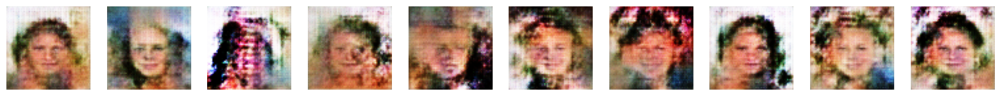

1500/1500 [==============================] - 223s 147ms/step - c_loss: -11.0776 - c_wass_loss: -13.4711 - c_gp: 0.2394 - g_loss: -29.2705 - c_acc: 82.7594 - g_acc: 27.6649
Epoch 2/5
1500/1500 [==============================] - ETA: 0s - c_loss: -4.1247 - c_wass_loss: -4.6742 - c_gp: 0.0549 - g_loss: -51.5612 - c_acc: 76.0938 - g_acc: 26.2656
Saved to ./output_2/generated_img_001.png


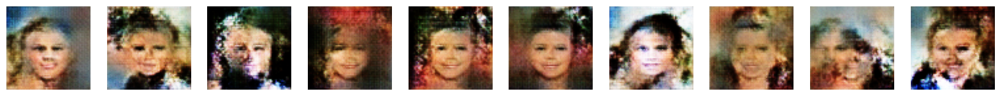

1500/1500 [==============================] - 219s 146ms/step - c_loss: -4.1247 - c_wass_loss: -4.6742 - c_gp: 0.0549 - g_loss: -51.5612 - c_acc: 76.0493 - g_acc: 26.3023
Epoch 3/5
1500/1500 [==============================] - ETA: 0s - c_loss: -3.2056 - c_wass_loss: -3.5939 - c_gp: 0.0388 - g_loss: -27.6837 - c_acc: 57.8962 - g_acc: 44.0197
Saved to ./output_2/generated_img_002.png


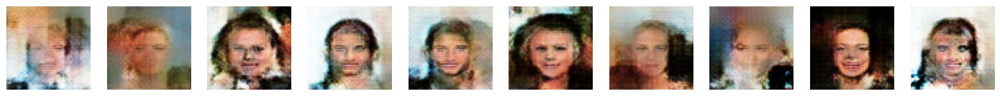

1500/1500 [==============================] - 217s 145ms/step - c_loss: -3.2056 - c_wass_loss: -3.5939 - c_gp: 0.0388 - g_loss: -27.6837 - c_acc: 57.9107 - g_acc: 44.0008
Epoch 4/5
1500/1500 [==============================] - ETA: 0s - c_loss: -2.2159 - c_wass_loss: -2.5719 - c_gp: 0.0356 - g_loss: -23.6735 - c_acc: 55.2437 - g_acc: 45.6396
Saved to ./output_2/generated_img_003.png


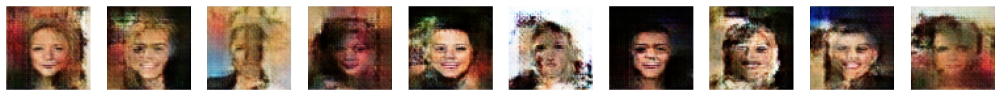

1500/1500 [==============================] - 217s 145ms/step - c_loss: -2.2159 - c_wass_loss: -2.5719 - c_gp: 0.0356 - g_loss: -23.6735 - c_acc: 55.2632 - g_acc: 45.6258
Epoch 5/5
1500/1500 [==============================] - ETA: 0s - c_loss: -2.5824 - c_wass_loss: -2.8852 - c_gp: 0.0303 - g_loss: -21.8316 - c_acc: 57.1038 - g_acc: 44.4229
Saved to ./output_2/generated_img_004.png


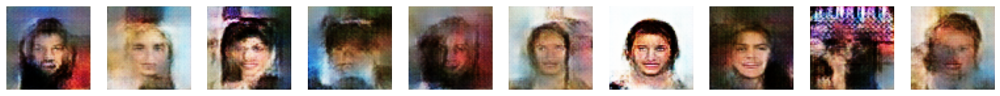

1500/1500 [==============================] - 217s 144ms/step - c_loss: -2.5824 - c_wass_loss: -2.8852 - c_gp: 0.0303 - g_loss: -21.8316 - c_acc: 57.0908 - g_acc: 44.4391


In [30]:
EPOCHS = 5
loss_history = LossHistory()

wgangp.fit(
    train,
    epochs=EPOCHS,
    steps_per_epoch=STEPS_PER_EPOCH,
    callbacks=[model_checkpoint_callback, tensorboard_callback, ImageGenerator(num_img=10, latent_dim=Z_DIM), loss_history],
)

Output of the following cell was cleared because of file size limitations.

In [ ]:
EPOCHS = 30
loss_history = LossHistory()

wgangp2.fit(
    train,
    epochs=EPOCHS,
    steps_per_epoch=STEPS_PER_EPOCH,
    callbacks=[model_checkpoint_callback, tensorboard_callback, ImageGenerator(num_img=10, latent_dim=Z_DIM), loss_history],
)

### Exploring the Latent Space

#### Generating random images

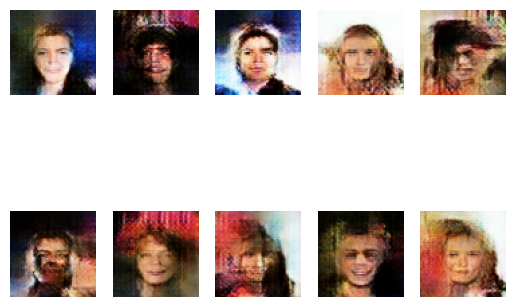

In [31]:
num_images = 10  #
random_latent_vectors = tf.random.normal(shape=(num_images, Z_DIM))
generated_images = generator(random_latent_vectors)

for i in range(num_images):
    plt.subplot(2, 5, i + 1)
    plt.imshow((generated_images[i] * 127.5 + 127.5).numpy().astype(np.uint8))  # Undo the normalization 
    plt.axis('off')

plt.show()


In [26]:
DATASET_PATH = "/home/kirle/Master/2cuatrimestre/Deep Learning/Practice/Lab5 - GANs/Dataset/archive/img_align_celeba"
BATCH_SIZE = 32
IMG_SIZE = 256

data_gen = ImageDataGenerator(rescale=1./255)
data_flow = data_gen.flow_from_directory(DATASET_PATH,
                                          target_size=(IMAGE_SIZE, IMAGE_SIZE), 
                                          batch_size=BATCH_SIZE,
                                          shuffle=True,
                                          class_mode='input',
                                          subset='training',
                                          color_mode='rgb')




Found 202599 images belonging to 1 classes.


Experiment with interpolation
of points in the latent space that correspond to real images, and observe the
images produced from this interpolation. 

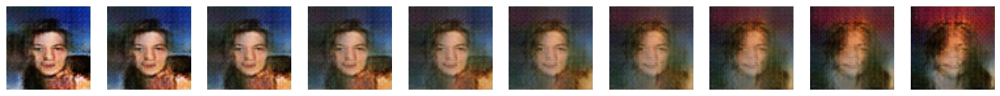

In [45]:
def interpolate_points(p1, p2, n_steps=10):
    # interpolate ratios between the points
    ratios = np.linspace(0, 1, num=n_steps)
    # linear interpolate vectors
    vectors = list()
    for ratio in ratios:
        v = (1.0 - ratio) * p1 + ratio * p2
        vectors.append(v)
    return np.vstack(vectors)

# randomly generate two points in the latent space
z1 = np.random.normal(0, 1, (1, Z_DIM))
z2 = np.random.normal(0, 1, (1, Z_DIM))

# interpolate points in latent space
interpolated_points = interpolate_points(z1, z2)

# use generator to generate images from interpolated points
interpolated_points = interpolated_points.reshape(-1, Z_DIM)
generated_images = generator.predict(interpolated_points)

# plot
n = len(generated_images)
plt.figure(figsize=(20, 4))
for i in range(n):
    ax = plt.subplot(2, n, i + 1)
    plt.imshow((generated_images[i] * 0.5) + 0.5) # scale the image back to the range [0,1]
    plt.axis('off')
plt.show()


## Conclussions

Over the test we have done, we have seen that the GANs are a very powerful tool but also quite computational expensive to train. In terms of strenghts, GANs demostrate more capabilities on generating diverse images, but also are much more challenging to design, with problems such as mode collapse or inestability during training, which can lead to much worse results than VAE. More time and experimentations with architecture and hyperparameters, as so computational resources, were needed to reach good results. 

VAEs on the other hand performs quite well on reconstruction, but may be worse in terms of generating high quality images. When the distribution complexity grows, VAEs may face a challenge to learn the latent space representation. More hyperparameter tunning and experiments need to be run over this model to improve them.

In conclussion, GANs and VAEs exhibit differences in their training processes. GANs often require careful tuning and monitoring to achieve stable training, while VAEs offer more straightforward training dynamics. The trade-off between image quality, diversity, and computational complexity should be considered when choosing between GANs and VAEs.
